In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

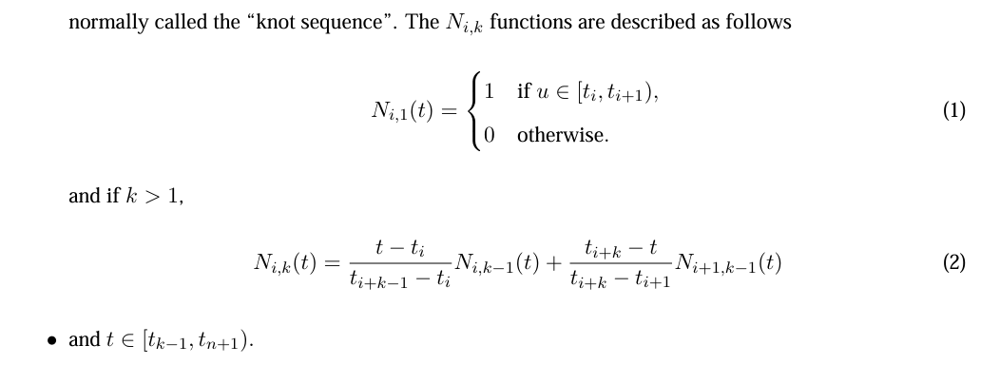

In [2]:
# B-spline basis function (recursive Cox-de Boor)
def de_boor_cox_basis(i, k, t, knots):
    """
    Recursively computes the B-spline basis function B(i, k) using the De Boor-Cox formula.
    Parameters:
    i : int Index of the basis function.
    k : int Degree of the B-spline.
    x : float The parameter value at which to evaluate.
    knot : np.ndarray The knot vector.
    Returns: float The computed basis function value B(i, k).
    """
    if k == 1:
        return 1.0 if knots[i] <= t < knots[i + 1] else 0.0
    denom1 = knots[i + k - 1] - knots[i]
    denom2 = knots[i + k] - knots[i + 1]

    term1 = 0.0
    term2 = 0.0
    if denom1 > 0:
        term1 = ((t - knots[i]) / denom1) * \
            de_boor_cox_basis(i, k - 1, t, knots)
    if denom2 > 0:
        term2 = ((knots[i + k] - t) / denom2) * \
            de_boor_cox_basis(i + 1, k - 1, t, knots)

    return term1 + term2

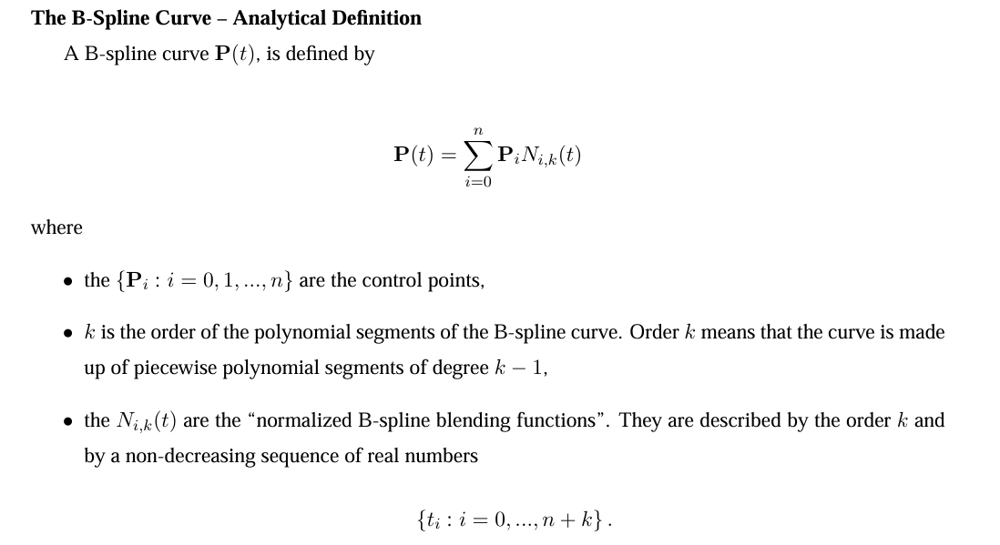

In [3]:
# B-spline curve computation
def bspline_point(t, control_points, k, knots):
    n = len(control_points)
    point = np.zeros(2)
    for i in range(n):
        b = de_boor_cox_basis(i, k, t, knots)
        point += b * control_points[i]
    return point



In [4]:
# Sample control points
control_points = np.array([
    [0, 0],
    [1, 2],
    [2, 3],
    [4, 3.5],
    [5, 2],
    [6, 0],
    [7, 2],
    [8, 4],
    [9, 4.5],
])
n = len(control_points)
degree = 3  # cubic B-spline

# Clamped knot vector
knots = np.concatenate((
    np.zeros(degree),
    np.linspace(0, 1, n - degree + 1),
    np.ones(degree)
))

# t values for animation
t_vals = np.linspace(knots[degree], knots[-degree-1], 200)

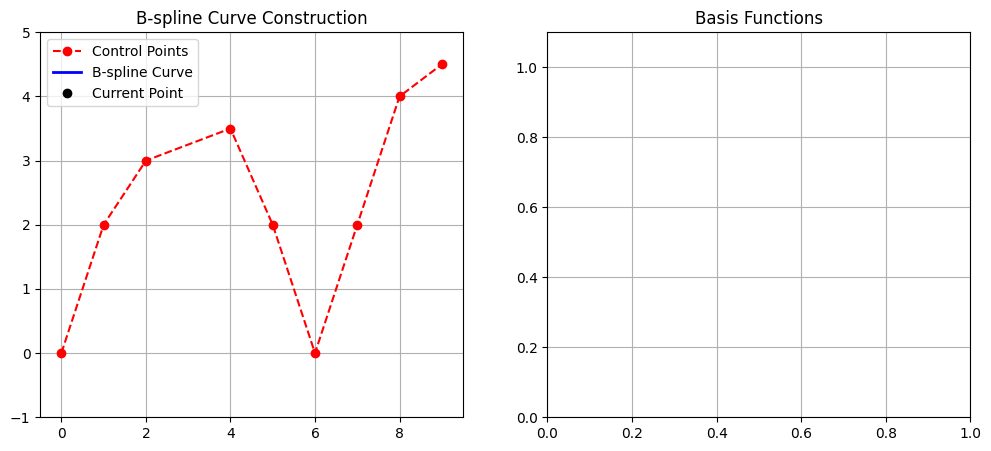

In [5]:
# Setup plot
fig, ax = plt.subplots(1, 2, figsize=(12, 5))
curve_ax = ax[0]
basis_ax = ax[1]

curve_ax.set_title("B-spline Curve Construction")
basis_ax.set_title("Basis Functions")

curve_ax.plot(control_points[:, 0], control_points[:,
              1], 'ro--', label="Control Points")
curve_line, = curve_ax.plot([], [], 'b-', lw=2, label="B-spline Curve")
moving_point, = curve_ax.plot([], [], 'ko', label="Current Point")

colors = plt.cm.viridis(np.linspace(0, 1, n))
basis_lines = [basis_ax.plot([], [], color=colors[i], label=f"N{i},{degree}")[
    0] for i in range(n)]

curve_ax.legend()
basis_ax.set_xlim(knots[degree], knots[-degree-1])
basis_ax.set_ylim(0, 1.1)
curve_ax.set_xlim(-0.5, 9.5)
curve_ax.set_ylim(-1, 5)
basis_ax.grid(True)
curve_ax.grid(True)


In [11]:
# Increase the animation embed limit
# You can adjust this value as needed (in MB)
plt.rcParams['animation.embed_limit'] = 50

In [12]:
computed_points = []

def animate(frame):
    t = t_vals[frame]
    # degree + 1 because k is order (degree + 1)
    point = bspline_point(t, control_points, degree+1, knots)
    computed_points.append(point)

    if len(computed_points) > 1:
        curve_line.set_data(*np.array(computed_points).T)

    moving_point.set_data([point[0]], [point[1]])

    # Update basis functions
    for i, line in enumerate(basis_lines):
        ts = np.linspace(knots[degree], knots[-degree-1], 200)
        bs = [de_boor_cox_basis(i, degree + 1, ti, knots)
              for ti in ts]  # degree + 1 here as well
        line.set_data(ts, bs)

    return [curve_line, moving_point] + basis_lines

In [13]:
ani = FuncAnimation(fig, animate, frames=len(t_vals), interval=50, blit=True)
plt.tight_layout()

# Display animation in Colab
HTML(ani.to_jshtml())

<Figure size 640x480 with 0 Axes>

In [8]:
# Compute and print curve points
print(f"Computed Curve Points: {len(t_vals)} in total")
for t in t_vals:
    point = bspline_point(t, control_points, degree+1, knots)
    print(f"t = {t:.3f} --> point = ({point[0]:.4f}, {point[1]:.4f})")

Computed Curve Points: 200 in total
t = 0.000 --> point = (0.0000, 0.0000)
t = 0.005 --> point = (0.0891, 0.1769)
t = 0.010 --> point = (0.1756, 0.3457)
t = 0.015 --> point = (0.2595, 0.5069)
t = 0.020 --> point = (0.3410, 0.6605)
t = 0.025 --> point = (0.4202, 0.8068)
t = 0.030 --> point = (0.4971, 0.9461)
t = 0.035 --> point = (0.5718, 1.0784)
t = 0.040 --> point = (0.6445, 1.2041)
t = 0.045 --> point = (0.7153, 1.3234)
t = 0.050 --> point = (0.7842, 1.4365)
t = 0.055 --> point = (0.8513, 1.5436)
t = 0.060 --> point = (0.9167, 1.6449)
t = 0.065 --> point = (0.9806, 1.7407)
t = 0.070 --> point = (1.0429, 1.8311)
t = 0.075 --> point = (1.1039, 1.9165)
t = 0.080 --> point = (1.1636, 1.9969)
t = 0.085 --> point = (1.2222, 2.0727)
t = 0.090 --> point = (1.2796, 2.1440)
t = 0.095 --> point = (1.3360, 2.2111)
t = 0.101 --> point = (1.3915, 2.2741)
t = 0.106 --> point = (1.4462, 2.3334)
t = 0.111 --> point = (1.5002, 2.3891)
t = 0.116 --> point = (1.5536, 2.4414)
t = 0.121 --> point = (1.606